#**Step 01: Clone the YOLOv10 Github Repo**

In [4]:
# Clone the YOLOv10 repository
!git clone https://github.com/THU-MIG/yolov10.git

# Change into the yolov10 directory
%cd yolov10


d:\Projects\netraAI\yolov10


Cloning into 'yolov10'...
d:\Projects\netraAI\.venv\lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


#**Step 02: Install All the Requried Packages**

In [8]:
# !pip install -q .
!pip install -e .


Obtaining file:///D:/Projects/netraAI/yolov10
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
  Building editable for ultralytics (pyproject.toml): started
  Building editable for ultralytics (pyproject.toml): finished with status 'done'
  Created wheel for ultralytics: filename=ultralytics-8.1.34-0.editable-py3-none-any.whl size=21859 sha256=d67f920c2afdc1794ea417f0a4b9dff60d02cdeddf979664ab8abe7de14f3f2c
  Stored in directory: C:\Users\vishn\AppData\Local\Temp\pip-ephem-wheel-cache-99umqmvi\wheels\01\4e\27\3bbdaf791c8f80ebe3fce3666107ebdb779db0

#**Step 03: Download the Pretrained Model Weights**

In [9]:
import os
import urllib.request
#Create a directory for the weights in the current working directory
weights_dir = os.path.join(os.getcwd(), 'weights')
os.makedirs(weights_dir, exist_ok = True)
#urls of the weights file
urls = ["https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10n.pt",
        "https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10s.pt",
        "https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10m.pt",
        "https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10b.pt",
        "https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10l.pt",
        "https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10x.pt"]

#Download each file
for url in urls:
  filename = os.path.basename(url)
  filepath = os.path.join(weights_dir, filename)
  urllib.request.urlretrieve(url, filepath)
  print(f"Downloaded: {filepath}")

Downloaded: d:\Projects\netraAI\yolov10\weights\yolov10n.pt
Downloaded: d:\Projects\netraAI\yolov10\weights\yolov10s.pt
Downloaded: d:\Projects\netraAI\yolov10\weights\yolov10m.pt
Downloaded: d:\Projects\netraAI\yolov10\weights\yolov10b.pt
Downloaded: d:\Projects\netraAI\yolov10\weights\yolov10l.pt
Downloaded: d:\Projects\netraAI\yolov10\weights\yolov10x.pt


#**Step 04: Download the Dataset from Roboflow**

In [10]:
import sys
print(sys.executable)

d:\Projects\netraAI\.venv\Scripts\python.exe


In [3]:
!pip install roboflow --quiet

from roboflow import Roboflow

# Authenticate
rf = Roboflow(api_key="C2enIcGR8osZHtaH7YKI")

# Load project and version
project = rf.workspace("akhil-shukla-naoc7").project("ocr-ealb0")
version = project.version(2)

# Download dataset in YOLOv8 format (compatible with YOLOv10 too)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to ocr-2 in yolov8:: 100%|██████████| 27142/27142 [00:18<00:00, 1459.20it/s]
IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


In [5]:
%cd D:/Projects/netraAI

D:\Projects\netraAI


This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.


#**Step 05: Train Custom Model**

In [1]:
import torch
print("CUDA Available:", torch.cuda.is_available())
print("GPU:", torch.cuda.get_device_name(0))

CUDA Available: True
GPU: NVIDIA GeForce RTX 3050 Laptop GPU


In [6]:
!yolo task=detect mode=train epochs=50 batch=16 plots=True model='yolov10/weights/yolov10n.pt' data='ocr-2/data.yaml'

New https://pypi.org/project/ultralytics/8.3.162 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.34 🚀 Python-3.10.17 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 Laptop GPU, 4096MiB)
engine\trainer: task=detect, mode=train, model=yolov10/weights/yolov10n.pt, data=ocr-2/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, val_period=1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, reti

D:\Projects\netraAI\yolov10\ultralytics\nn\tasks.py:733: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(file, map_location="cpu")
Traceback (most recent cal

##**Step 06: Examine Training Results**

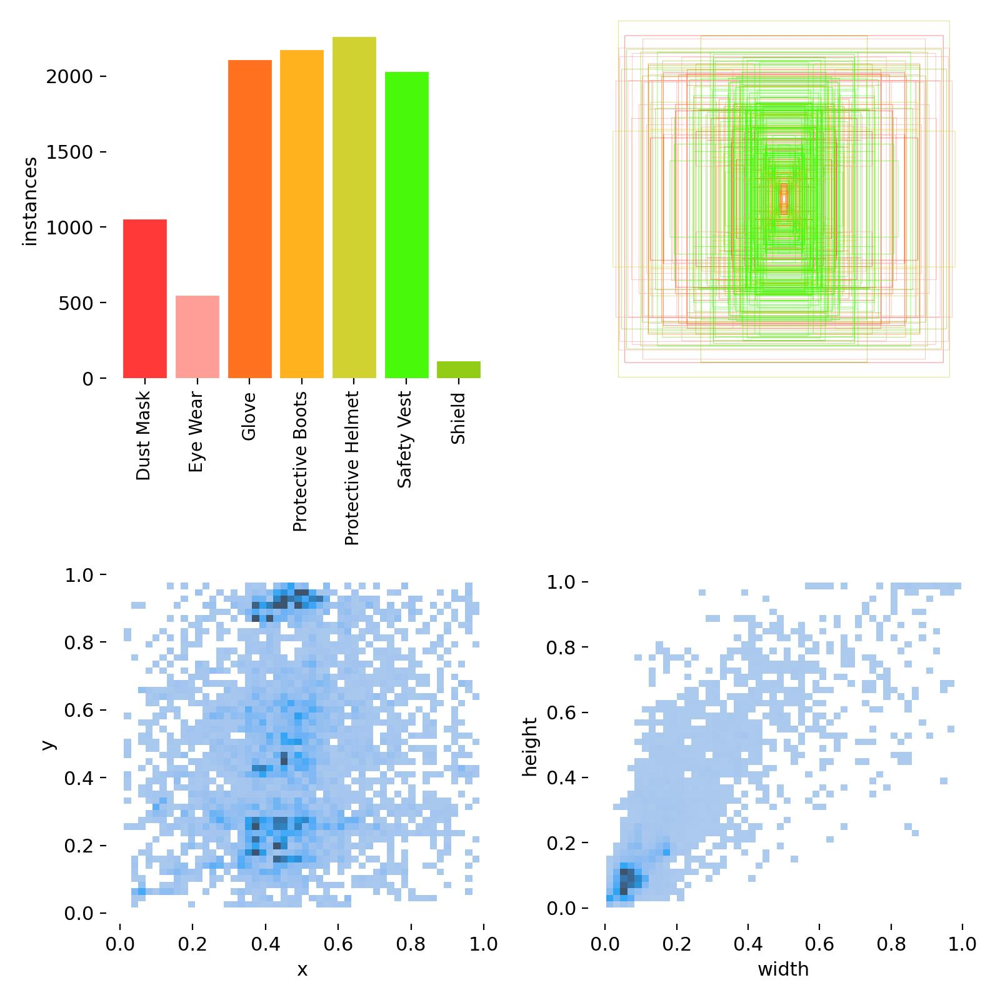

In [ ]:
from IPython.display import Image

Image("/content/yolov10/runs/detect/train3/labels.jpg")

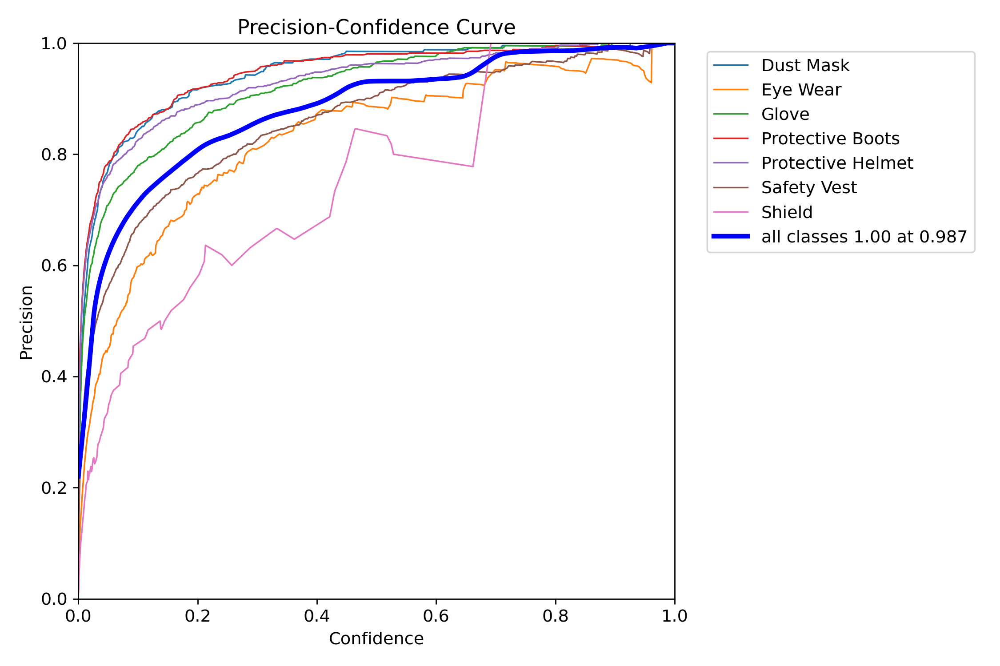

In [ ]:
Image("/content/yolov10/runs/detect/train3/P_curve.png")

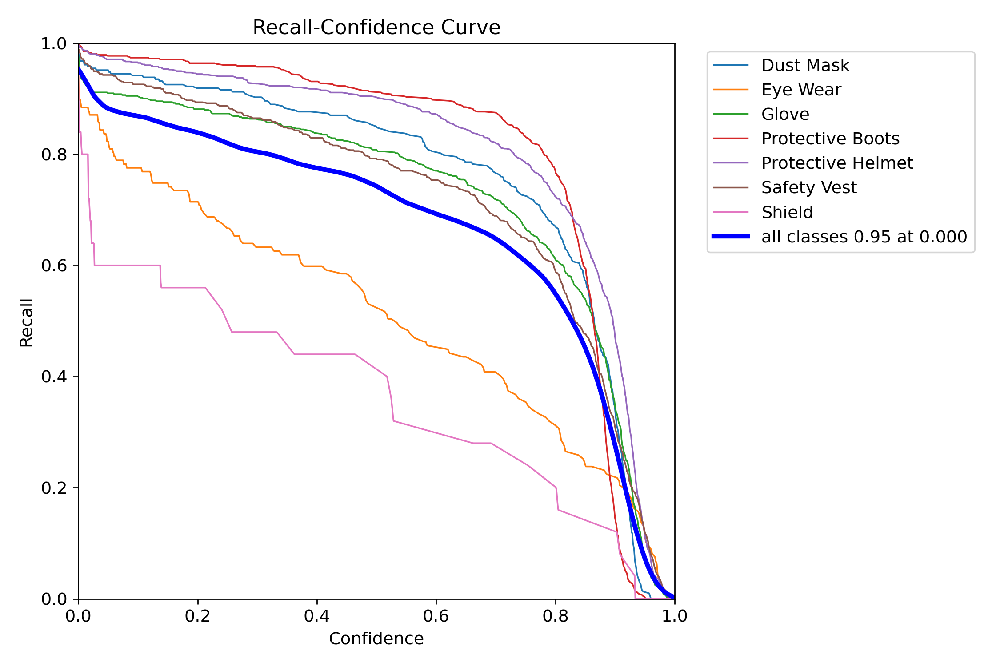

In [ ]:
Image("/content/yolov10/runs/detect/train3/R_curve.png")

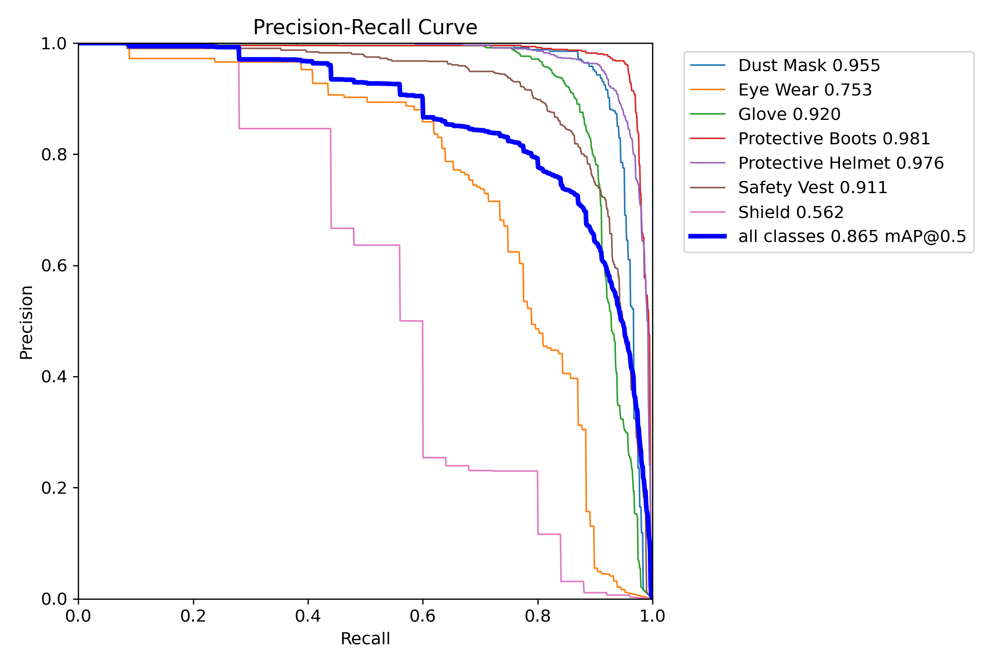

In [ ]:
Image("/content/yolov10/runs/detect/train3/PR_curve.png")

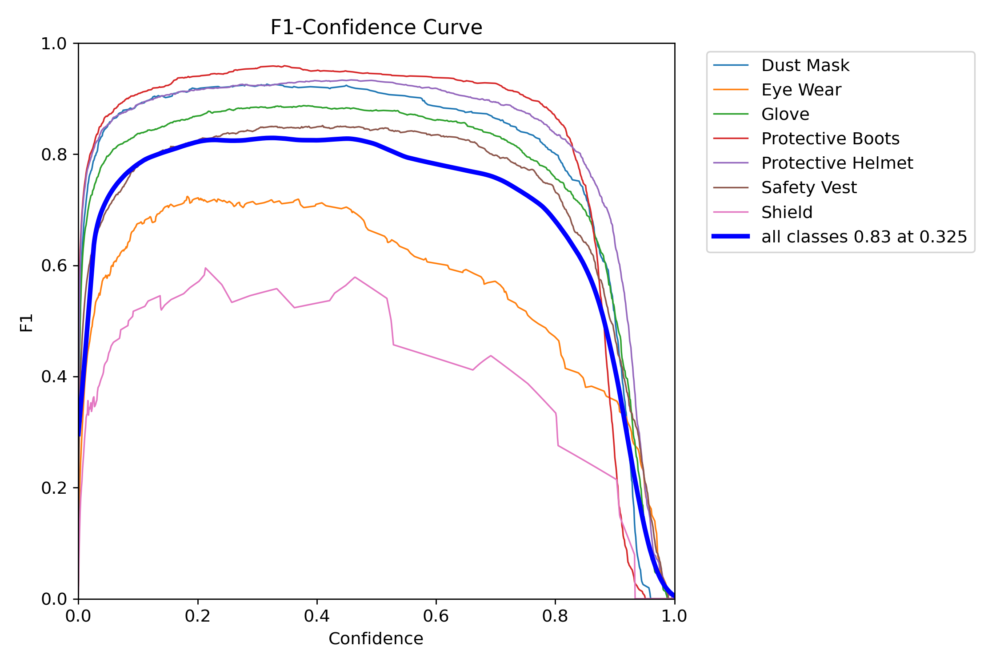

In [ ]:
Image("/content/yolov10/runs/detect/train3/F1_curve.png")

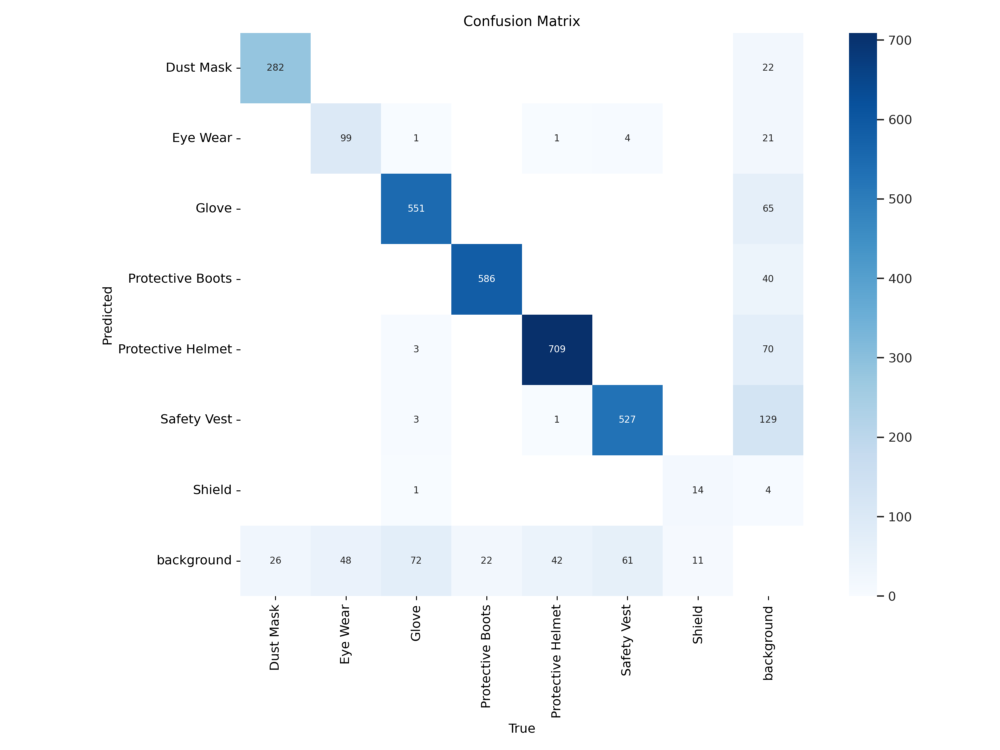

In [ ]:
Image("/content/yolov10/runs/detect/train3/confusion_matrix.png")

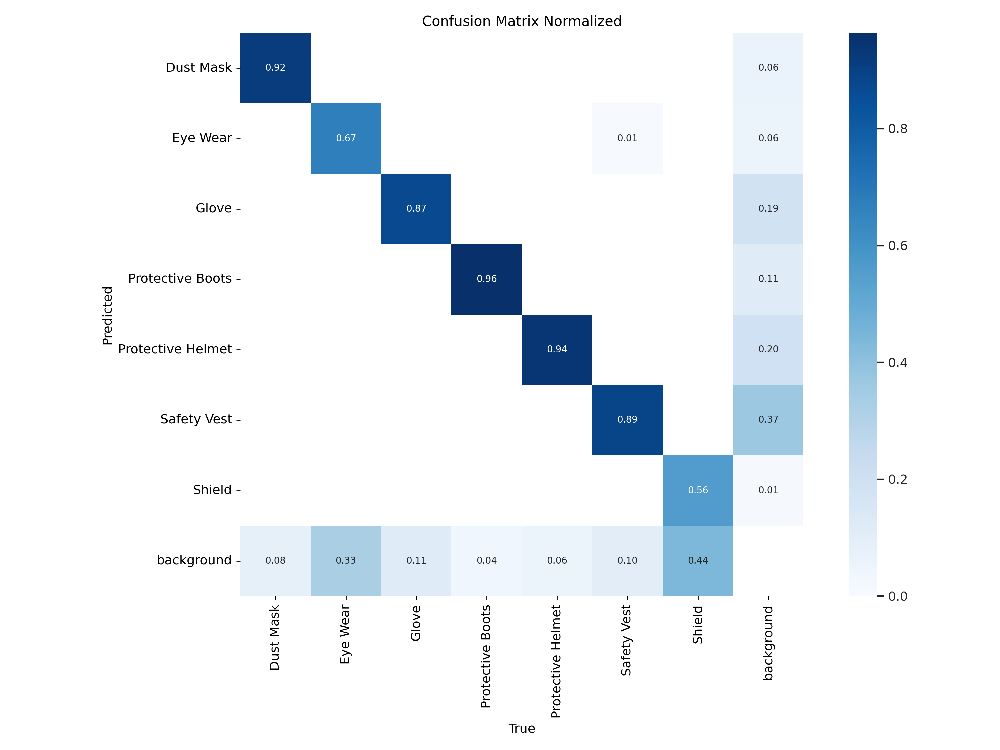

In [ ]:
Image("/content/yolov10/runs/detect/train3/confusion_matrix_normalized.png")

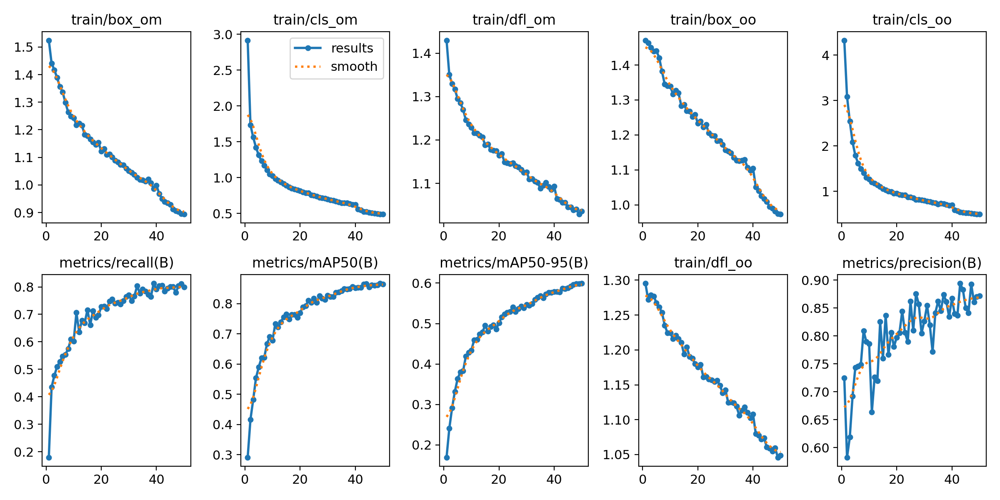

In [ ]:
Image("/content/yolov10/runs/detect/train3/results.png")

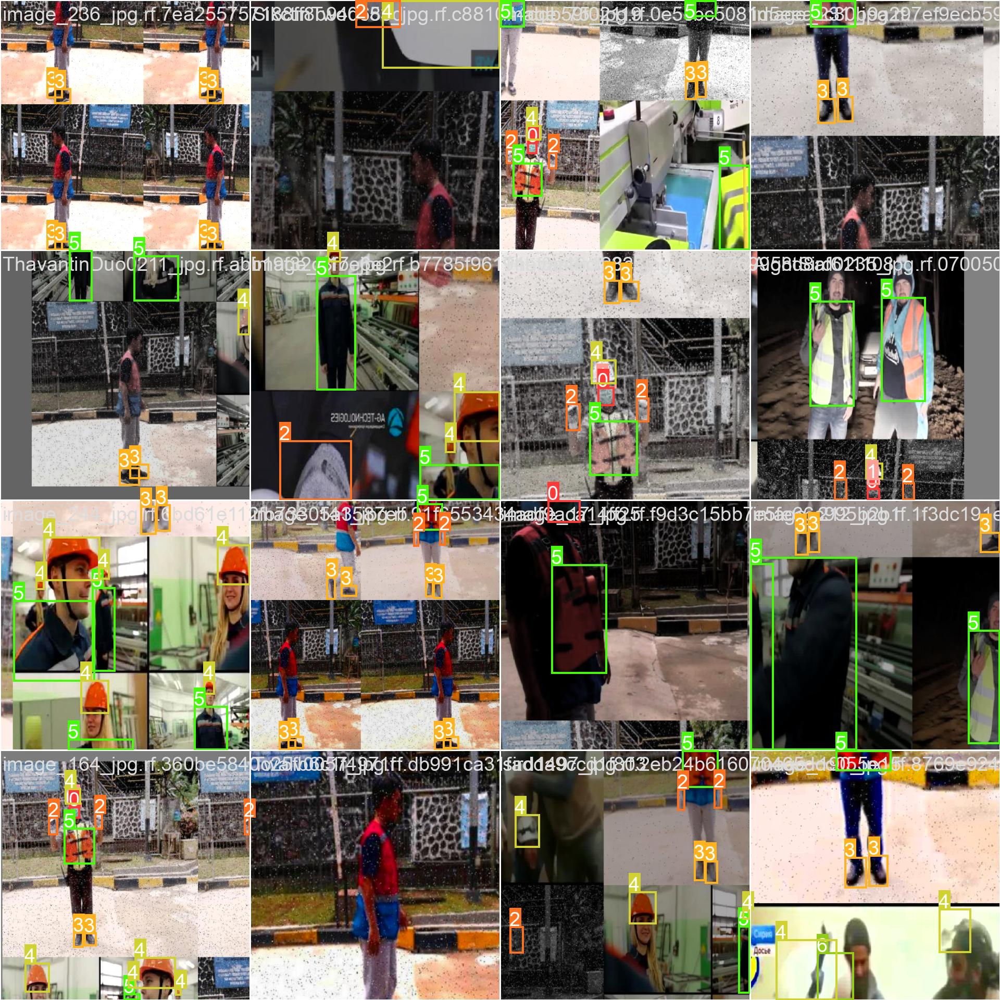

In [ ]:
Image("/content/yolov10/runs/detect/train3/train_batch0.jpg")

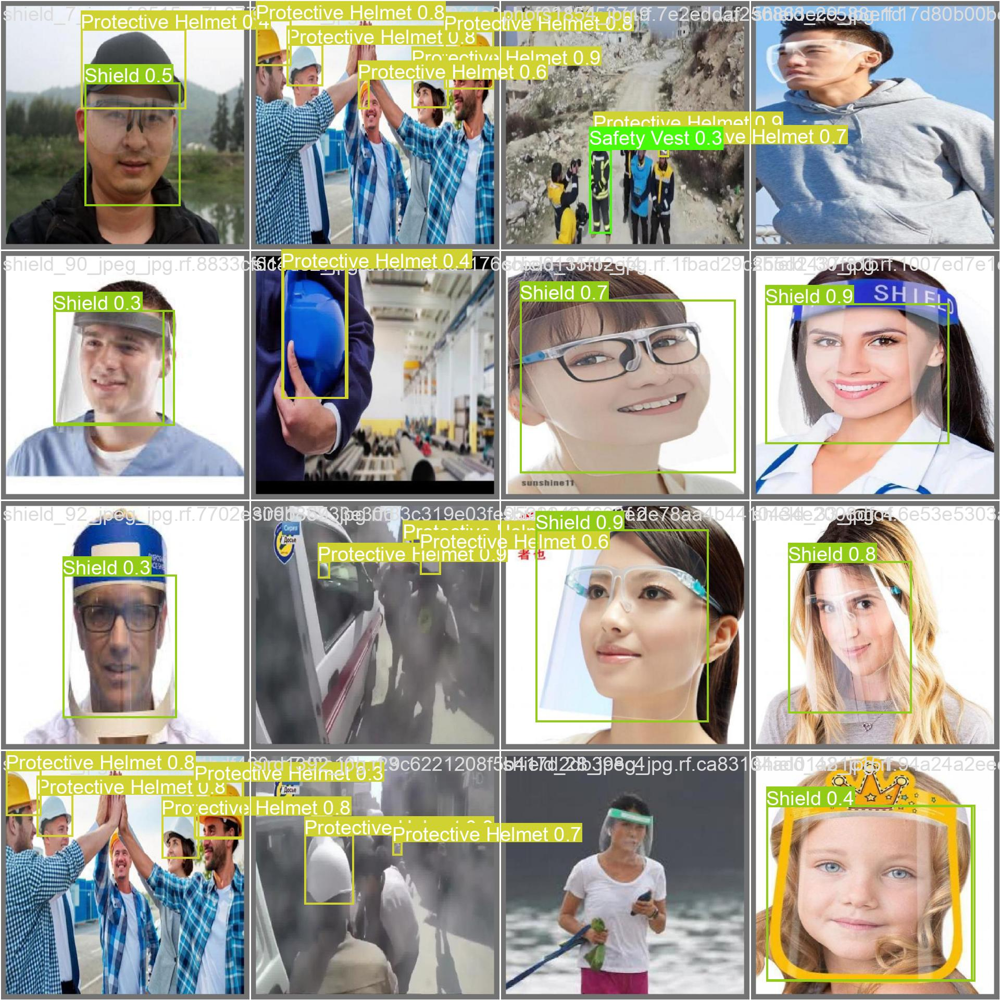

In [ ]:
Image("/content/yolov10/runs/detect/train3/val_batch0_pred.jpg")

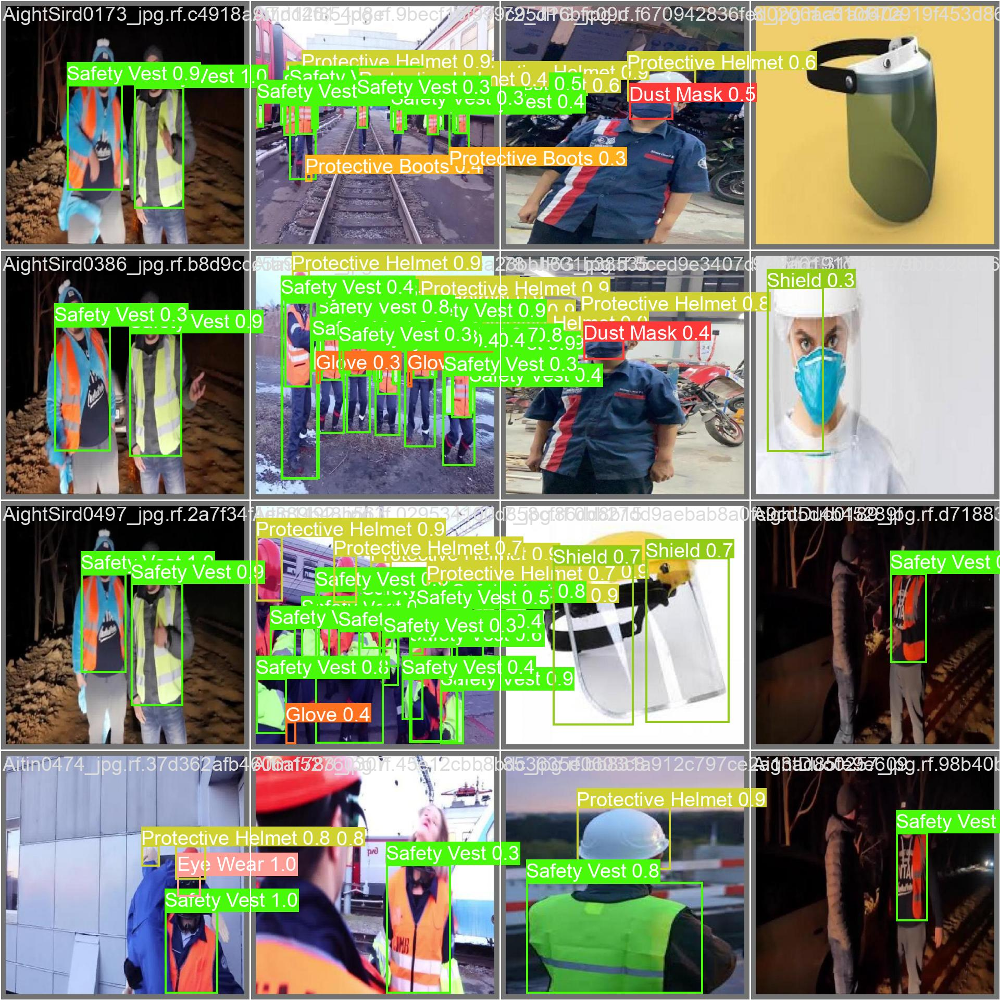

In [ ]:
Image("/content/yolov10/runs/detect/train3/val_batch1_pred.jpg")

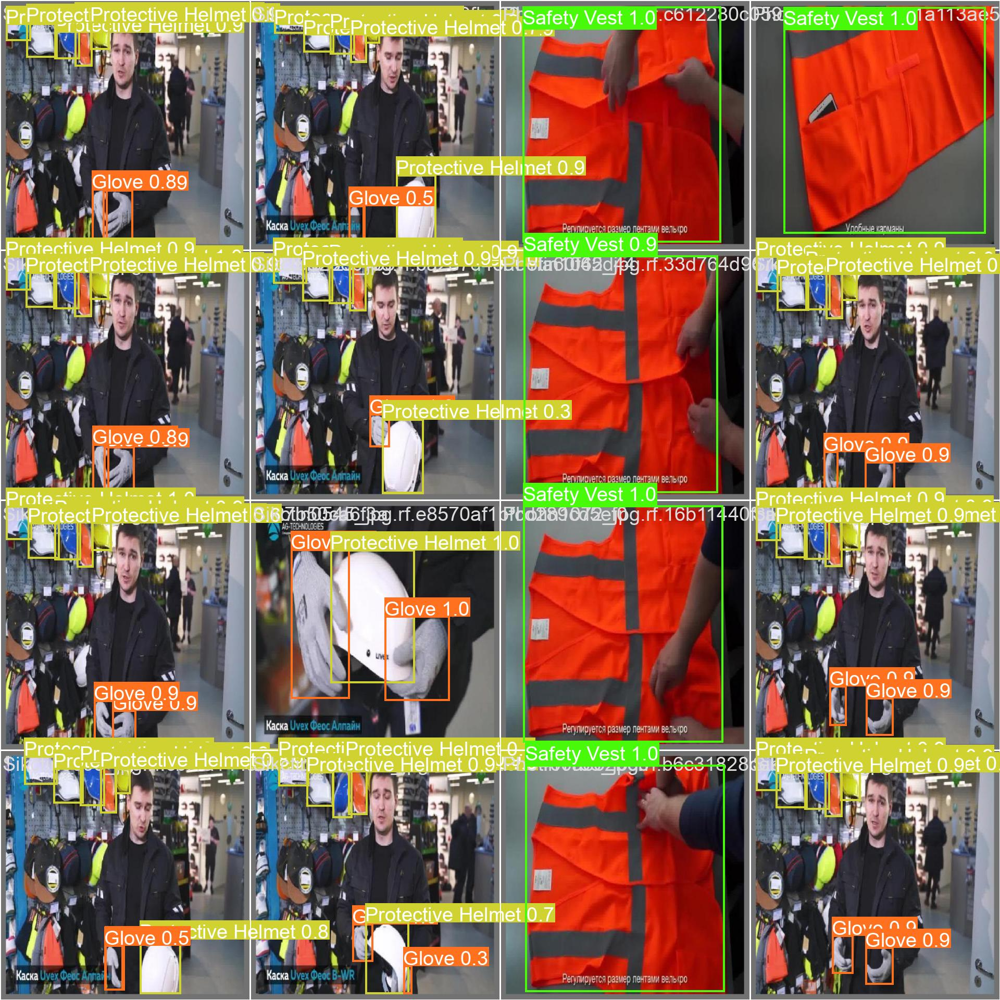

In [ ]:
Image("/content/yolov10/runs/detect/train3/val_batch2_pred.jpg")

#**Step 07: Download the Model Weights from Drive**

In [6]:
!gdown "https://drive.google.com/uc?id=1TMj360d48efgA0t4ZzlhBWLXEflgFaIR&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1TMj360d48efgA0t4ZzlhBWLXEflgFaIR&confirm=t
To: /content/yolov10/best.pt
100% 5.76M/5.76M [00:00<00:00, 34.6MB/s]


#**Step 08: Inference on Image**

In [7]:
!gdown "https://drive.google.com/uc?id=1a-xBN5jl_y_MqeAILwhKSrHHZ9pAZyFb&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1a-xBN5jl_y_MqeAILwhKSrHHZ9pAZyFb&confirm=t
To: /content/yolov10/image1.jpg
100% 70.2k/70.2k [00:00<00:00, 87.0MB/s]


In [8]:
!yolo task=detect mode=predict conf=0.25 save=True model='best.pt' source='image1.jpg'

Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2697146 parameters, 0 gradients, 8.2 GFLOPs

image 1/1 /content/yolov10/image1.jpg: 640x640 2 Protective Helmets, 25.6ms
Speed: 9.4ms preprocess, 25.6ms inference, 397.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/yolov10/runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


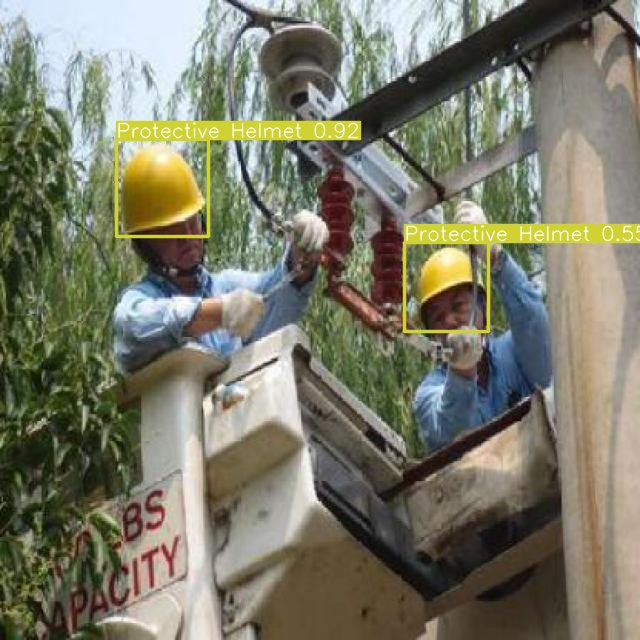

In [9]:
from IPython.display import Image
Image(filename='runs/detect/predict/image1.jpg')


In [10]:
!gdown "https://drive.google.com/uc?id=1ACZp9gmtjEdIY-SHp8K0xdR0D8Gjd3j3&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1ACZp9gmtjEdIY-SHp8K0xdR0D8Gjd3j3&confirm=t
To: /content/yolov10/image2.jpg
100% 77.7k/77.7k [00:00<00:00, 73.1MB/s]


In [11]:
!yolo task=detect mode=predict conf=0.25 save=True model='best.pt' source='image2.jpg'

Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2697146 parameters, 0 gradients, 8.2 GFLOPs

image 1/1 /content/yolov10/image2.jpg: 640x640 4 Protective Bootss, 3 Protective Helmets, 5 Safety Vests, 14.7ms
Speed: 2.8ms preprocess, 14.7ms inference, 171.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/yolov10/runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


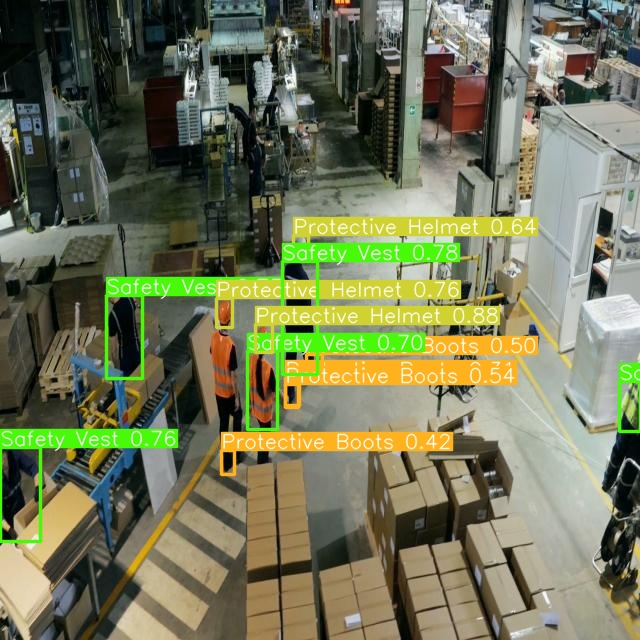

In [12]:
from IPython.display import Image
Image(filename='runs/detect/predict2/image2.jpg')


#**Step 09: Download the Demo Videos**

In [13]:
!gdown "https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t
To: /content/yolov10/PPE_Part1.mp4
100% 14.2M/14.2M [00:00<00:00, 15.1MB/s]


In [14]:
!gdown "https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t
To: /content/yolov10/PPE_Part2.mp4
100% 11.1M/11.1M [00:00<00:00, 18.2MB/s]


#**Step 10: Inference on Video**

In [15]:
!yolo task=detect mode=predict conf=0.25 save=True model='best.pt' source='PPE_Part1.mp4'

Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2697146 parameters, 0 gradients, 8.2 GFLOPs

video 1/1 (frame 1/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 Protective Helmets, 4 Safety Vests, 100.8ms
video 1/1 (frame 2/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 Protective Helmets, 2 Safety Vests, 13.3ms
video 1/1 (frame 3/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 Protective Helmets, 3 Safety Vests, 10.0ms
video 1/1 (frame 4/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 Protective Helmets, 3 Safety Vests, 12.7ms
video 1/1 (frame 5/310) /content/yolov10/PPE_Part1.mp4: 384x640 1 Protective Helmet, 3 Safety Vests, 14.7ms
video 1/1 (frame 6/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 Protective Helmets, 3 Safety Vests, 12.3ms
video 1/1 (frame 7/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 Protective Helmets, 3 Safety Vests, 17.3ms
video 1/1 (frame 8/310) /content/yolov10/PPE_Part1.mp4: 384x640 2 P

#**Display the Output Video**

In [16]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = 'runs/detect/predict3/PPE_Part1.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
!yolo task=detect mode=predict conf=0.25 save=True model='best.pt' source='PPE_Part2.mp4'

Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv10n summary (fused): 285 layers, 2697146 parameters, 0 gradients, 8.2 GFLOPs

video 1/1 (frame 1/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 84.8ms
video 1/1 (frame 2/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 11.2ms
video 1/1 (frame 3/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 16.7ms
video 1/1 (frame 4/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 12.5ms
video 1/1 (frame 5/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 13.0ms
video 1/1 (frame 6/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 12.2ms
video 1/1 (frame 7/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 13.9ms
video 1/1 (frame 8/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 10.1ms
video 1/1 (frame 9/267) /content/yolov10/PPE_Part2.mp4: 384x640 (no detections), 19.8ms
video 1/1 (frame 10/267) /content/yolo

In [ ]:
!rm '/content/result_compressed.mp4'

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = 'runs/detect/predict4/PPE_Part2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)